In [ ]:
import cv2 as cv
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
class Histogram:
  """
  Class to calculate the histogram of an image, images passed as arguments must be in RGB format
  """
  def __init__(self):
    pass

  """
  Draws the histograms passed as argument side by side
  param:
    histograms: a dict with the histograms, the keys are the titles and the values are the histograms
  """
  @staticmethod
  def compare_histograms(histograms):
    if histograms is None:
      raise Exception("Histograms not found")

    columns = len(histograms)
    fig, axs = plt.subplots(1, columns, figsize=(10, 5))
    fig.suptitle('Histograms\n\n')
    fig.subplots_adjust(wspace=0.3)

    for idx, key in enumerate(histograms):
      axs[idx].set_title(key)
      axs[idx].plot(histograms[key])
      axs.axis('off')

    plt.show()

  @staticmethod
  def draw_histogram(image, axis):
    """
    draw the histogram of the passed image
    params:
      image: the image in a RGB format
      axis: the axis to draw the histogram
    return:
      the axe object
    """
    if image is None:
      raise Exception("Histograms not found")

    colors = ["blue", "red", "green"]
    axis.set_xlim([0, 256])
    for channel_id, color in enumerate(colors):
        histogram, bin_edges = np.histogram(
            image[:, :, channel_id], bins=256, range=(0, 256)
        )
        axis.plot(bin_edges[0:-1], histogram, color=color)

    axis.set_title("Color Histogram")
    axis.set_xlabel("Color value")
    axis.set_ylabel("Pixel count")


In [ ]:
from ctypes import ArgumentError

class ImageNoise:

  def __init__(self, image_path):
      self.image = cv.imread(image_path, cv.IMREAD_COLOR)

      """
      a dictionary with the noise images
      the keys are the (type of noise + probability) and the values are an array with the images
      example:
        pepper salt noise with probability 0.01:
          key is 'pepper_salt_0.01'
          value is an array with the images
          [image1, image2, image3, ...]
      """
      self.pepper_salt_noise_images = {}

      """
      a dictionary with the noise images
      the keys are the (type of noise + variance) and the values are an array with the images
      example:
        gaussian with variance of 25:
          key is 'gaussian_noise_25'
          value is an array with the images
          [image1, image2, image3, ...]
      """
      self.gaussian_noise_images = {}

      if self.image is None:
          raise ArgumentError('Image not found')

      self.image = cv.cvtColor(self.image, cv.COLOR_BGR2RGB)

  #region add pepper salt
  """
  Creates a image with pepper salt noise
  params:
    prob: probability of the noise
    amount: amount of images
  each time this funtions is called the key in the dictionary, if it already exists, has it's values
  substituted by the new images
  """
  def pepper_salt_noise(self, prob, amount):
    pepper_salt_noise_imgs = []
    for i in range(amount):
      pepper_salt_noise_img = self.__add_noise__(self.image, prob)
      pepper_salt_noise_imgs.append(pepper_salt_noise_img)

    self.pepper_salt_noise_images['pepper_salt_' + str(prob)] = pepper_salt_noise_imgs


  def __add_noise__(self, noise_img, prob):
    output = noise_img.copy()

    if prob < 0 or prob > 1:
      raise ArgumentError('Probability must be between 0 and 1')

    #height, width, channels(rgb)
    h, w, c = output.shape

    # quantity of noisy pixels based on the probability passed as argument
    noisy_pixels = int(h*w*prob)

    for _ in range(noisy_pixels):

      # gets a random pixel as a noisy pixel
      row, col = np.random.randint(0, h), np.random.randint(0, w)
      pepper_or_salt = np.random.rand()

      # 50-50 chance of being pepper or salt noise
      # pepper is black pixels
      # salt is white pixels
      if pepper_or_salt < 0.5:
        output[row, col] = [255, 255, 255]
      else:
        output[row, col] = [0, 0, 0]

    return output
  #endregion

  #region add gaussion noise
  """
  Creates a image with gaussian noise
  params:
    std: standard deviation of the noise
    amount: amount of images
  each time this funtions is called the key in the dictionary, if it already exists, has it's values
  substituted by the new images
  """
  def gaussian_noise(self, std, amount):
    images = []
    key = 'gaussian_noise_' + str(std)
    for i in range(amount):
      gaussian_noise_img = self.__add_gaussian_noise__(self.image, std)
      images.append(gaussian_noise_img)

    self.gaussian_noise_images[key] = images

  def __add_gaussian_noise__(self, image, std):
    output = image.copy()

    # ordem dos atributos
    # media, desvio padrão, tamanho da distribuição
    # np.random.normal cria números aleatórios de acordo com uma distribuição gaussiana
    noise = np.random.normal(0, std, output.shape)
    noise = np.array(noise, dtype=np.uint8)

    # unites the noise with the image
    output = cv.add(output, noise)

    return output
  #endregion

  """
  Shows the original image
  """
  def show_original_image(self):
    plt.xticks([])
    plt.yticks([])
    plt.imshow(self.image)
    plt.show()

  #region functions to visualize pepper salt noise
  """
  Shows the noise images, with the prob passed as argument
  params:
    prob: probability of the noise, is used to construct the key in the dictionary
  """
  def show_pepper_salt_noise_images(self, prob):
    key = 'pepper_salt_' + str(prob)
    title = f"pepper salt with {prob*100}% of noisy pixels"

    if len(self.pepper_salt_noise_images[key]) == 0:
      raise ArgumentError('No noise images found, create a noise image')

    images = self.pepper_salt_noise_images[key]

    number_images = len(images)

    fig, axs = plt.subplots(1, number_images, figsize=(15, 5))
    fig.suptitle(title, fontsize=16)

    if number_images == 1:
      axs.axis("off")
      axs.imshow(images[0])
      plt.show()
      return

    for idx, image in enumerate(images):
      axs[idx].axis('off')
      axs[idx].imshow(image)

    plt.show()

  """
  Shows side by side, the left image is the original image and the images in the right are the noisy images
  Shows images in the order they were constructed
  It's one image per key in the dictionary
  """
  def compare_pepper_salt_noise(self):
    fig, axs = plt.subplots(1, len(self.pepper_salt_noise_images) + 1, figsize=(15, 5))

    axs[0].set_title('Original Image')
    axs[0].axis('off')
    axs[0].imshow(self.image)

    for idx, key in enumerate(self.pepper_salt_noise_images):
      images = self.pepper_salt_noise_images[key]
      key_component = key.split("_")

      percentage = float(key_component[-1])*100

      title = f"pepper salt ({percentage}% noisy pixels)"
      axs[idx + 1].set_title(title)
      axs[idx + 1].axis('off')
      axs[idx + 1].imshow(images[0])

    plt.show()
  #endregion

  #region funtions to visualize gaussina noise
  """
  Shows the noise images, with the std passed as argument
  params:
    std: standard deviation of the noise, is used to construct the key in the dictionary
  """
  def show_gaussian_noise_images(self, std):
    key = 'gaussian_noise_' + str(std)
    title = f"gaussian noise with std of {std}"

    images = self.gaussian_noise_images[key]

    if len(images) == 0:
      raise ArgumentError('No Gaussian noise images found, create a Gaussian noise image')


    fig, axs = plt.subplots(1, len(images), figsize=(15, 5))
    fig.suptitle(title, fontsize=16)

    if len(images) == 1:
      axs.axis("off")
      axs.imshow(images[0])
      plt.show()

    for idx, image in enumerate(images):
      axs[idx].axis('off')
      axs[idx].imshow(image)

    plt.show()

  """
  Shows side by side, the left image is the original image and the images in the right are the noisy images
  Shows images in the order they were constructed
  It's one image per key in the dictionary
  """
  def compare_gaussian_noise(self):
    fig, axs = plt.subplots(1, len(self.gaussian_noise_images) + 1, figsize=(15, 5))

    axs[0].set_title('Original Image')
    axs[0].axis('off')
    axs[0].imshow(self.image)

    for idx, key in enumerate(self.gaussian_noise_images):
      images = self.gaussian_noise_images[key]
      key_component = key.split("_")

      std = float(key_component[-1])

      title = f"Gaussian Noise ({std} std)"
      axs[idx + 1].set_title(title)
      axs[idx + 1].axis('off')
      axs[idx + 1].imshow(images[0])

    plt.show()
  #endregion

  def select_image(self, key = None):

    if key is not None:
      if key.split("_")[0] == 'gaussian':
        return self.gaussian_noise_images[key][0]
      else:
        return self.pepper_salt_noise_images[key][0]

    print("Pepper salt noise images keys")
    for key in self.pepper_salt_noise_images:
      print("\t",key)

    print("Gaussian noise images keys")
    for key in self.gaussian_noise_images:
      print("\t",key)

    image_name = input("Select an image, input the key or original: ")

    if image_name == 'original':
      return self.image
    else:
      if image_name.split("_")[0] == 'gaussian':
        return self.gaussian_noise_images[image_name][0]
      else:
        return self.pepper_salt_noise_images[image_name][0]

  #region show histogram
  """
  Shows the histogram of the image key passed as argument
  params:
    key: the key of the image in the dictionary
  """
  def show_histogram(self, key):
    identifier = key.split("_")[0]

    match identifier:
      case 'gaussian':
        image = self.gaussian_noise_images[key][0]
      case 'pepper_salt':
        image = self.pepper_salt_noise_images[key][0]
      case _:
        image = self.image
    fig= plt.figure()
    hist_ax = fig.add_axes([0,0, 1, 1])
    Histogram.draw_histogram(image, hist_ax)
    fig.show()
  #endregion

  def compare_image_histogram(self, key):
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    fig.suptitle('Histograms', fontsize=16)
    fig.tight_layout()

    if key is None:
      key = "original"
    identifiers = key.split("_")

    match identifiers[0]:
      case 'gaussian':
        image = self.gaussian_noise_images[key][0]
        title = f'Gaussian noise {identifiers[-1]} std'
      case 'pepper':
        image = self.pepper_salt_noise_images[key][0]
        title = f'Pepper salt noise {identifiers[-1]}% probability'
      case _:
        image = self.image
        title = 'Original image'
    axs[0].set_title(title)
    axs[0].axis('off')
    axs[0].imshow(image)

    Histogram.draw_histogram(image, axs[1])

    plt.show()

  def compare_histograms_of(self, key):

    identifier = key.split("_")[0]

    match identifier:
      case 'gaussian':
        images = self.gaussian_noise_images
      case 'pepper':
        images = self.pepper_salt_noise_images
      case _:
        raise ArgumentError('Invalid key')

    fig, axs = plt.subplots(1, len(images), figsize=(20,5))
    fig.suptitle(f'Histograms of {identifier} noise', fontsize=16)
    fig.tight_layout()
    fig.subplots_adjust(wspace=0.3)

    Histogram.draw_histogram(self.image, axs[0])
    axs[0].set_title('Original image')

    for idx, key in enumerate(images):
      # ignores the first image because of size constraints, as the first it's the least affected, i chose to ignore her histogram
      if idx == 0:
        continue
      image = images[key][0]

      identifiers = key.split("_")


      Histogram.draw_histogram(image, axs[idx])

      match identifiers[0]:
        case 'gaussian':
          axs[idx].set_title(f'Gaussian noise {identifiers[-1]} std')
        case 'pepper':
          axs[idx].set_title(f'Pepper salt noise {float(identifiers[-1])*100}% probability')

    plt.show()

In [ ]:
image_noise = ImageNoise('/content/lena_pdi.jpg')

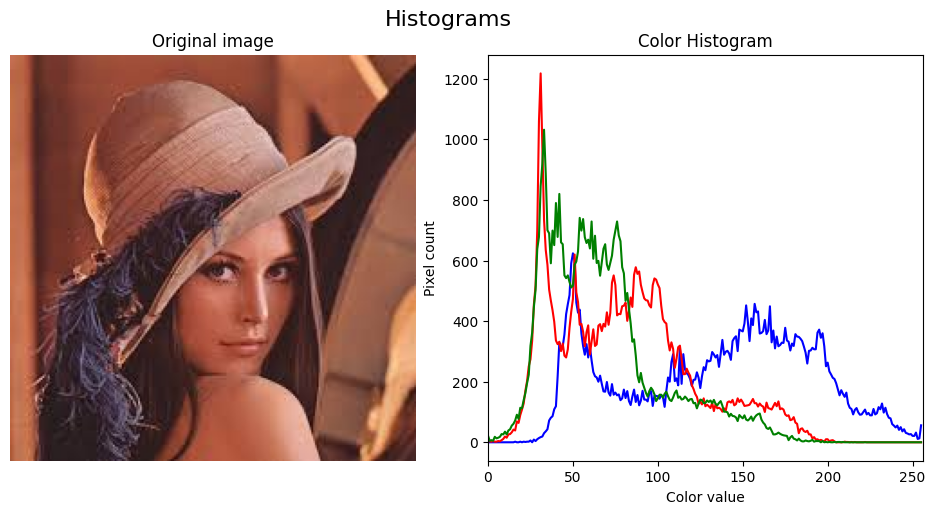

In [ ]:
image_noise.compare_image_histogram(None)

# Pepper salt noise

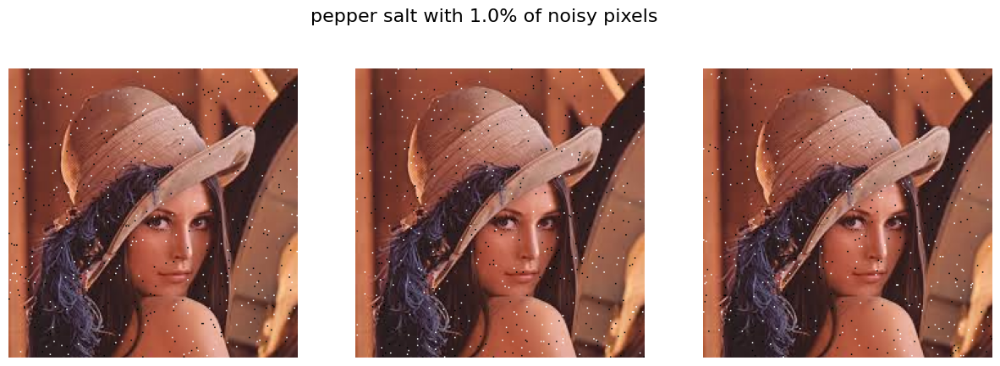

In [ ]:
image_noise.pepper_salt_noise(0.01, 3)
image_noise.show_pepper_salt_noise_images(0.01)

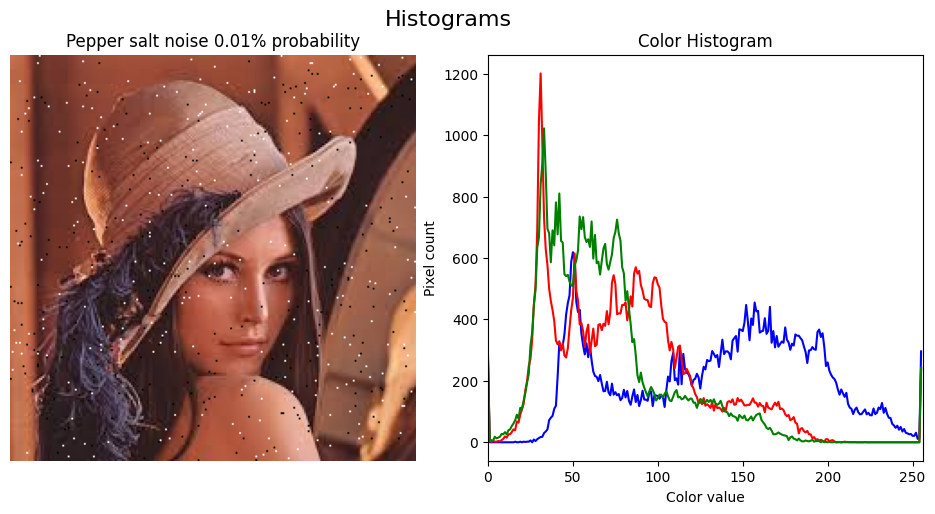

In [ ]:
image_noise.compare_image_histogram('pepper_salt_0.01')

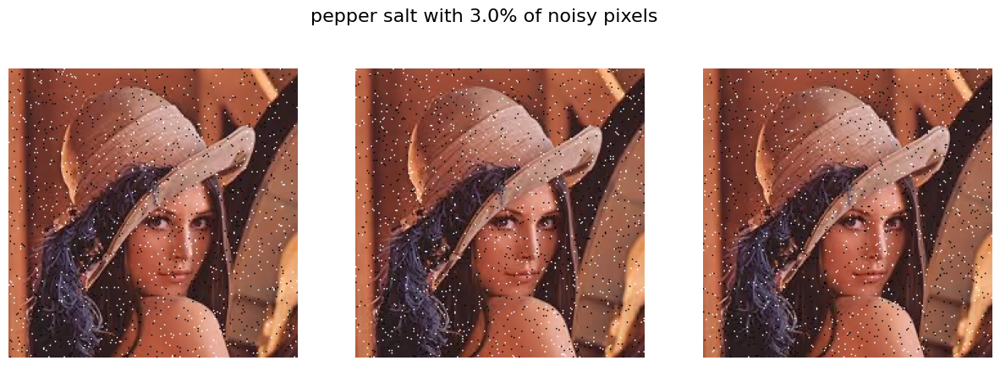

In [ ]:
image_noise.pepper_salt_noise(0.03, 3)
image_noise.show_pepper_salt_noise_images(0.03)

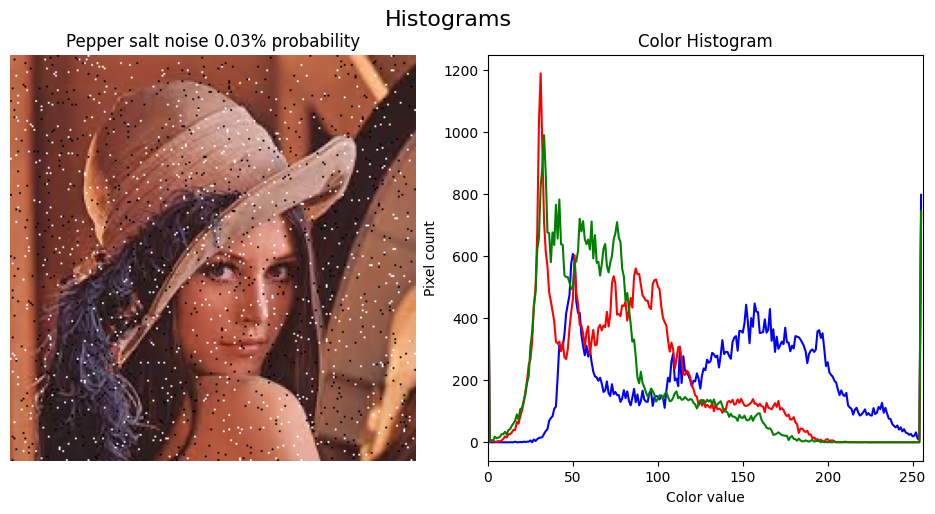

In [ ]:
image_noise.compare_image_histogram('pepper_salt_0.03')

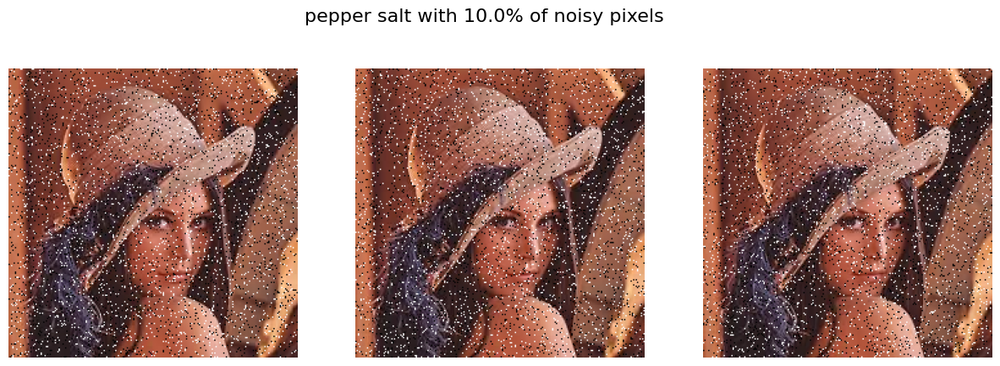

In [ ]:
image_noise.pepper_salt_noise(0.1, 3)
image_noise.show_pepper_salt_noise_images(0.1)

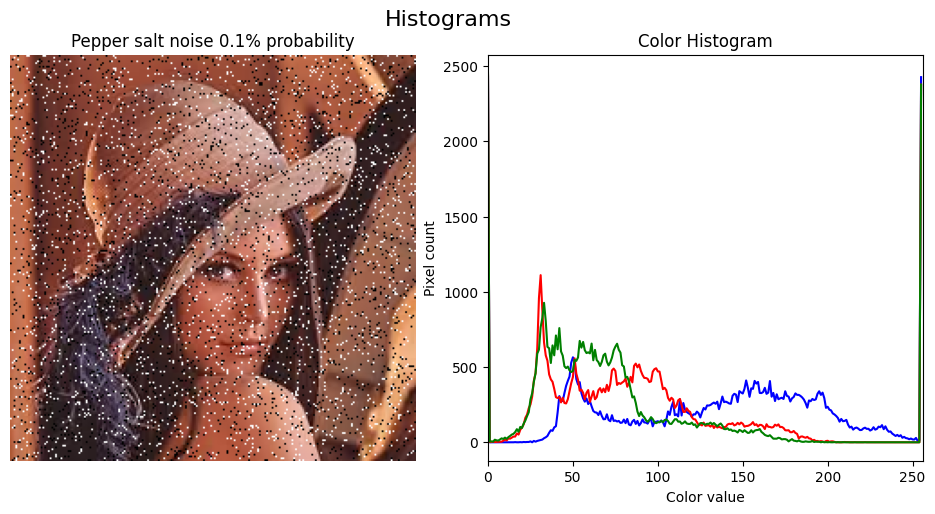

In [ ]:
image_noise.compare_image_histogram('pepper_salt_0.1')

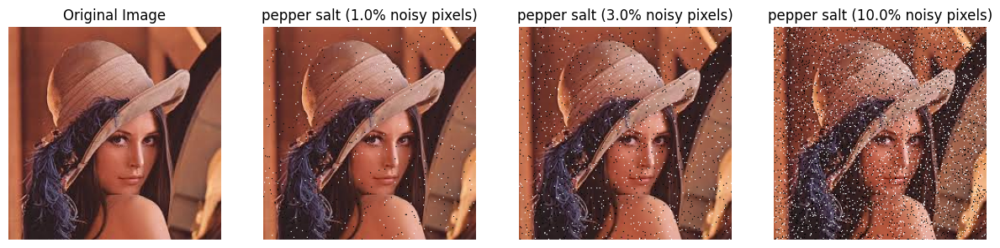

In [ ]:
image_noise.compare_pepper_salt_noise()

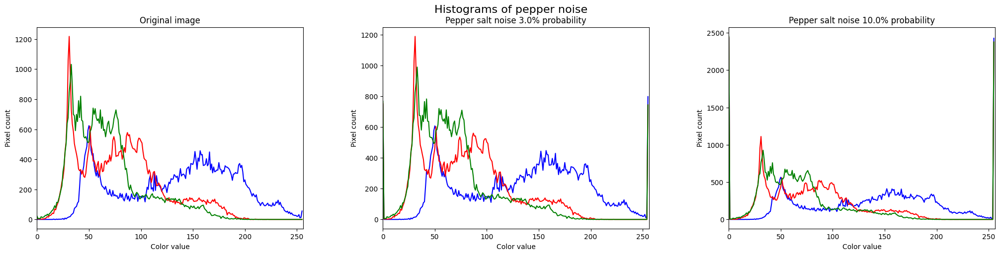

In [ ]:
image_noise.compare_histograms_of("pepper_salt")

# Gaussian Noise

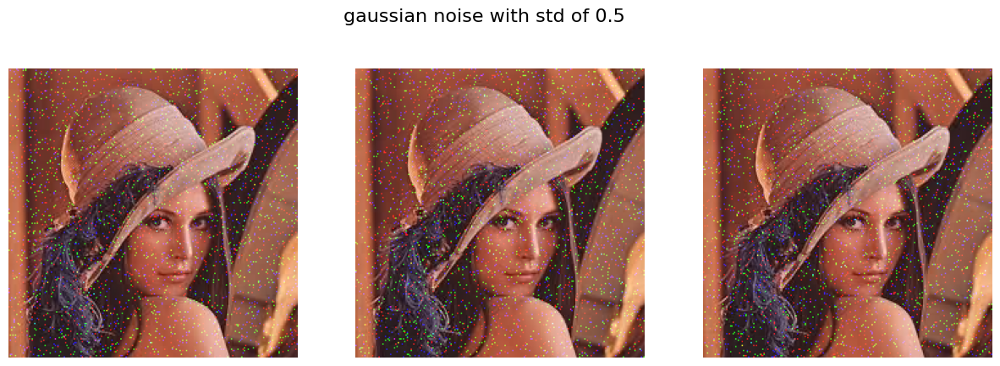

In [ ]:
image_noise.gaussian_noise(0.5, 3)
image_noise.show_gaussian_noise_images(0.5)

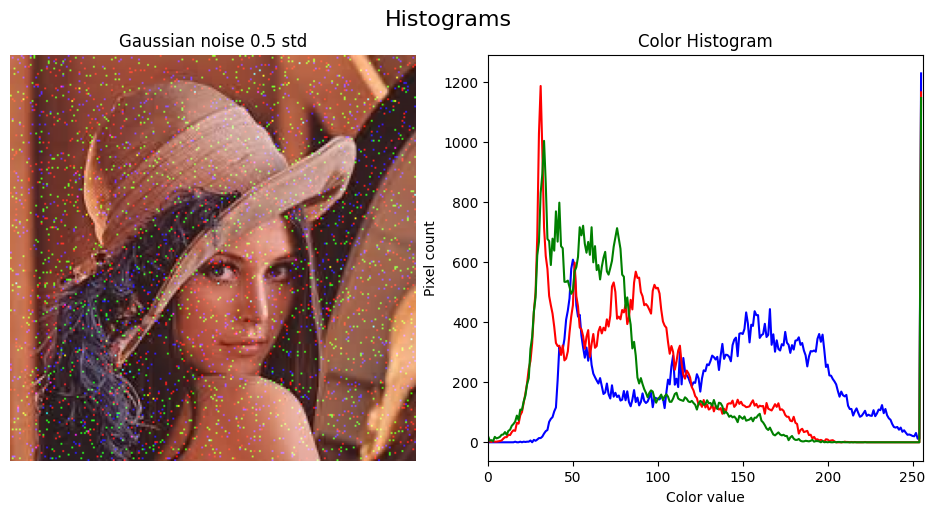

In [ ]:
image_noise.compare_image_histogram('gaussian_noise_0.5')


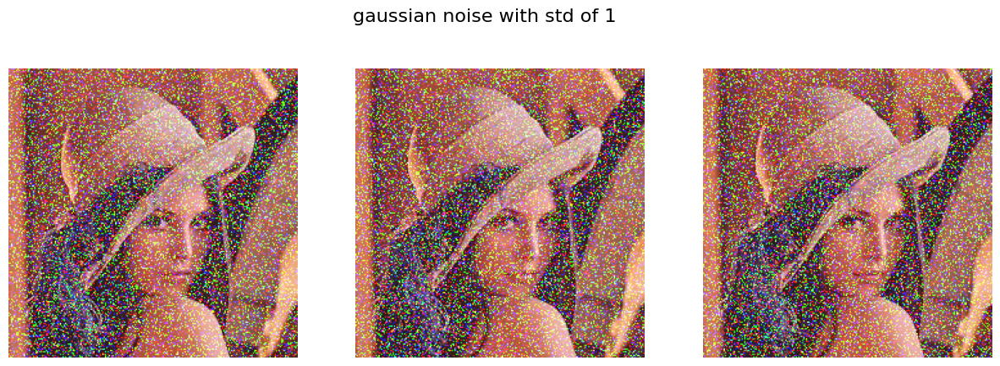

In [ ]:
image_noise.gaussian_noise(1, 3)
image_noise.show_gaussian_noise_images(1)

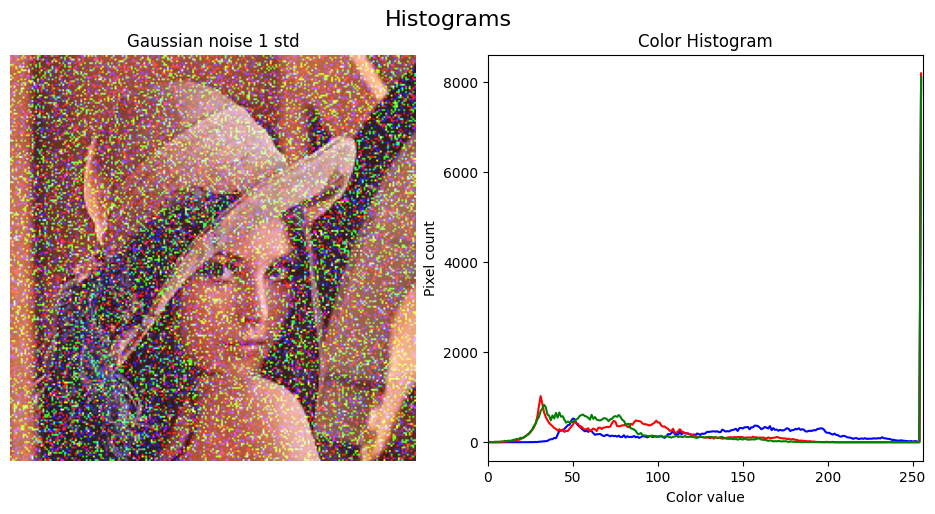

In [ ]:
image_noise.compare_image_histogram('gaussian_noise_1')


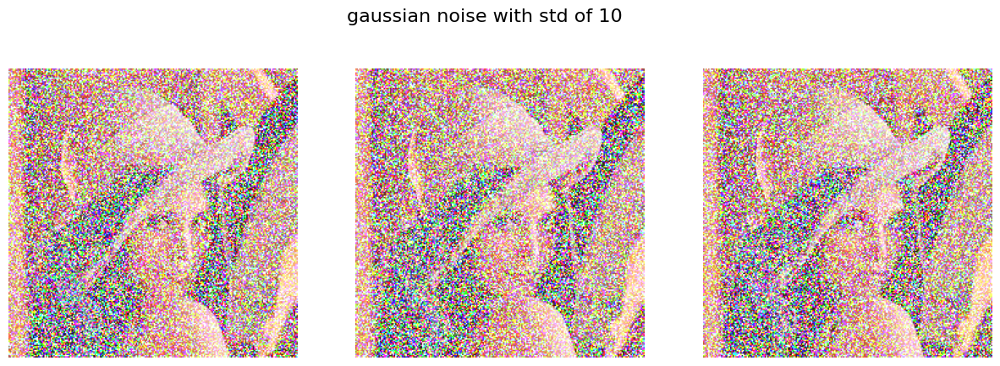

In [ ]:
image_noise.gaussian_noise(10, 3)
image_noise.show_gaussian_noise_images(10)

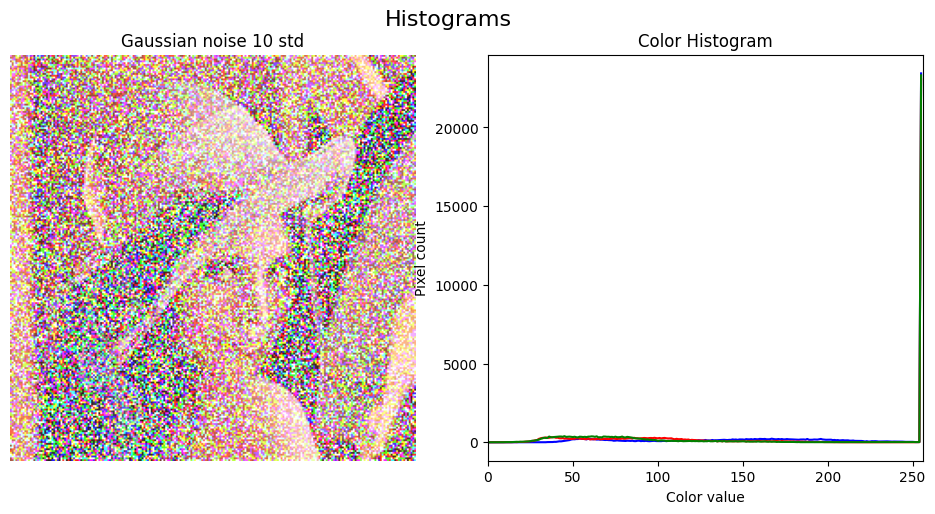

In [ ]:
image_noise.compare_image_histogram('gaussian_noise_10')


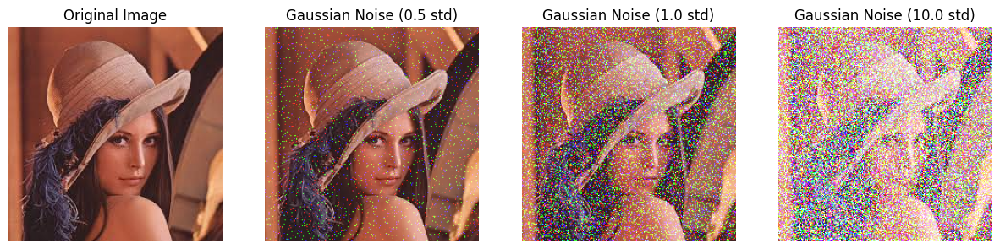

In [ ]:
image_noise.compare_gaussian_noise()

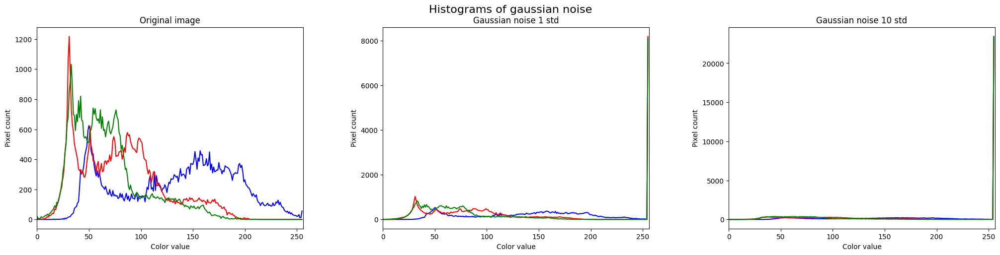

In [ ]:
image_noise.compare_histograms_of("gaussian")

# Pepper salt noise vs Gaussian noise

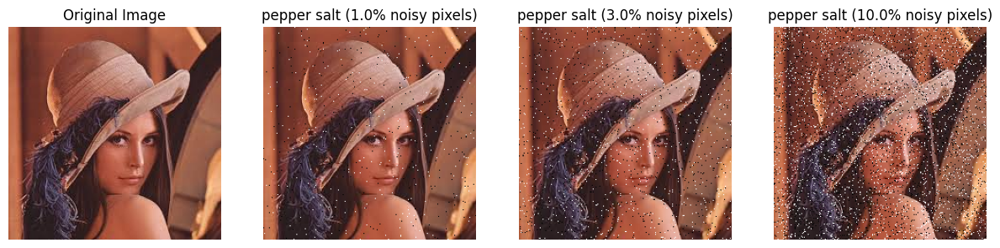

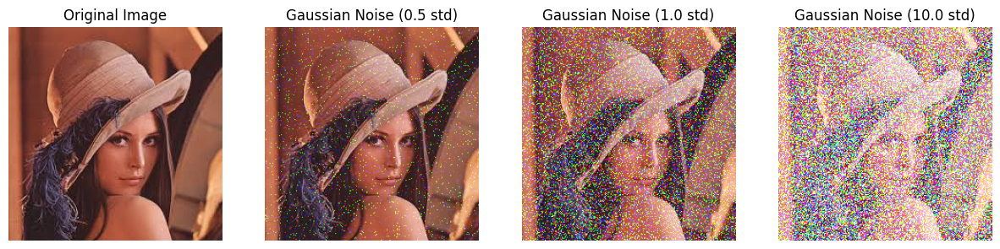

In [ ]:
image_noise.compare_pepper_salt_noise()
image_noise.compare_gaussian_noise()

# Filters

In [ ]:
"""
Filtros no domínio de espaço
  filtro de média
  filtro gaussiano

Filtro no domínio de frequência
  bilateral filter
"""
class Filter:
  def __init__(self, image, image_title):
    self.original_image = image
    self.image_title = image_title
    """
    receives the filtered images
    the keys are the kernel size and the values are the filtered images
    """
    self.median_filtered_images = {}
    self.gaussian_filtered_images = {}
    self.bilateral_filtered_images = {}


  #region filter functions
  """
  apply a median filter in the image passed as an argument
  params:
    kernel_size: size of the kernel, must be odd
  return:
    the filtered image
  """
  def median_filter(self, kernel_size):
    if kernel_size % 2 == 0:
      raise ArgumentError('Kernel size must be odd')

    output = cv.medianBlur(self.original_image, kernel_size)
    key = str(kernel_size)
    self.median_filtered_images[key] = output

  """
  apply a gaussian filter in the image passed as an argument
  params:
    kernel_size: size of the kernel, must be odd
  """
  def gaussian_filter(self, kernel_size):
    if kernel_size % 2 == 0:
      raise ArgumentError('Kernel size must be odd')


    output = cv.GaussianBlur(self.original_image, (kernel_size, kernel_size), 0)
    key = str(kernel_size)

    self.gaussian_filtered_images[key] = output

  def bilateral_filter(self,  kernel_size):
    if kernel_size % 2 == 0:
      raise ArgumentError('Kernel size must be odd')


    output = cv.bilateralFilter(self.original_image, d=kernel_size, sigmaColor=75, sigmaSpace=75)
    key = str(kernel_size)

    self.bilateral_filtered_images[key] = output
  #endregion

  def show_filtering_image(self):
    plt.axis('off')
    plt.title(self.image_title)
    plt.imshow(self.original_image)
    plt.show()

  """
  Shows the filtered images, accompagnated with the original image
  """
  def show_median_filtered_image(self):
    if len(self.median_filtered_images) == 0:
      raise ArgumentError('No filtered images found, apply a filter')

    fig, axs = plt.subplots(1, len(self.median_filtered_images)+1, figsize=(15, 5))
    fig.suptitle('Median filtered images', fontsize=16)

    axs[0].axis('off')
    axs[0].set_title(self.image_title)
    axs[0].imshow(self.original_image)

    for idx, key in enumerate(self.median_filtered_images):
      axs[idx+1].axis('off')
      axs[idx+1].set_title(f'median filter (kernel size: {key})')
      axs[idx+1].imshow(self.median_filtered_images[key])

  """
  Shows the filtered images, accompagnated with the original image
  """
  def show_gaussian_filtered_image(self):
    if len(self.gaussian_filtered_images) == 0:
      raise ArgumentError('No filtered images found, apply a filter')

    fig, axs = plt.subplots(1, len(self.gaussian_filtered_images)+1, figsize=(15, 5))
    fig.suptitle('Bilateral filtered images', fontsize=16)

    axs[0].axis('off')
    axs[0].set_title(self.image_title)
    axs[0].imshow(self.original_image)

    for idx, key in enumerate(self.gaussian_filtered_images):
      axs[idx+1].axis('off')
      axs[idx+1].set_title(f'gaussian filter (kernel size: {key})')
      axs[idx+1].imshow(self.gaussian_filtered_images[key])

  def show_bilateral_filtered_image(self):
    if len(self.bilateral_filtered_images) == 0:
      raise ArgumentError('No filtered images found, apply a filter')

    fig, axs = plt.subplots(1, len(self.bilateral_filtered_images)+1, figsize=(15, 5))
    fig.suptitle('Bilateral filtered images', fontsize=16)

    axs[0].axis('off')
    axs[0].set_title(self.image_title)
    axs[0].imshow(self.original_image)

    for idx, key in enumerate(self.bilateral_filtered_images):
      axs[idx+1].axis('off')
      axs[idx+1].set_title(f'gaussian filter (kernel size: {key})')
      axs[idx+1].imshow(self.bilateral_filtered_images[key])


### filtering pepper salt noise with 1% of probability

In [ ]:
filter_pepper_salt = Filter(image_noise.select_image("pepper_salt_0.1"), 'pepper salt noise (1% probability)')

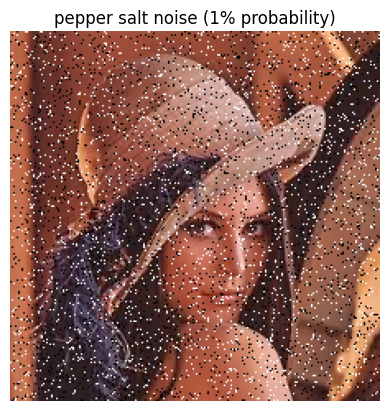

In [ ]:
filter_pepper_salt.show_filtering_image()

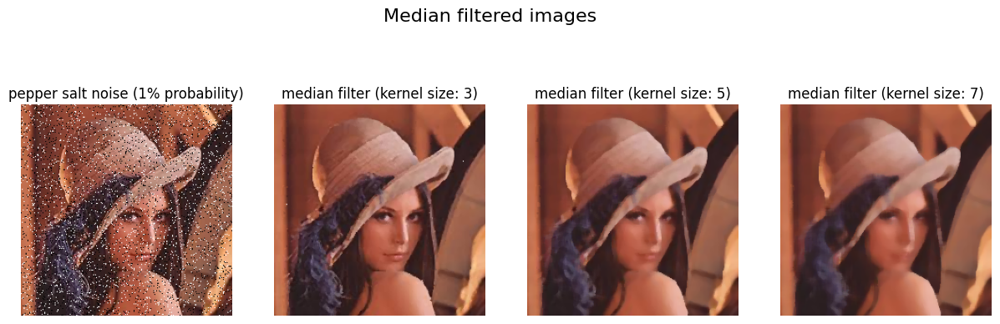

In [ ]:
for i in [3, 5, 7]:
  filter_pepper_salt.median_filter(i)
filter_pepper_salt.show_median_filtered_image()

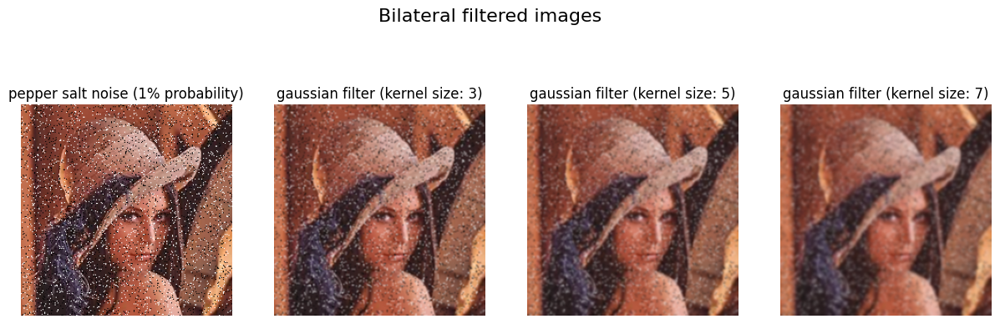

In [ ]:
for i in [3, 5, 7]:
  filter_pepper_salt.gaussian_filter(i)
filter_pepper_salt.show_gaussian_filtered_image()

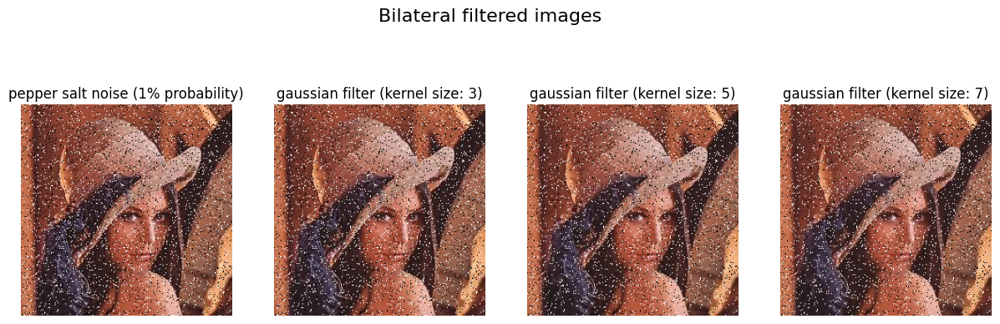

In [ ]:
for i in [3, 5, 7]:
  filter_pepper_salt.bilateral_filter(i)
filter_pepper_salt.show_bilateral_filtered_image()

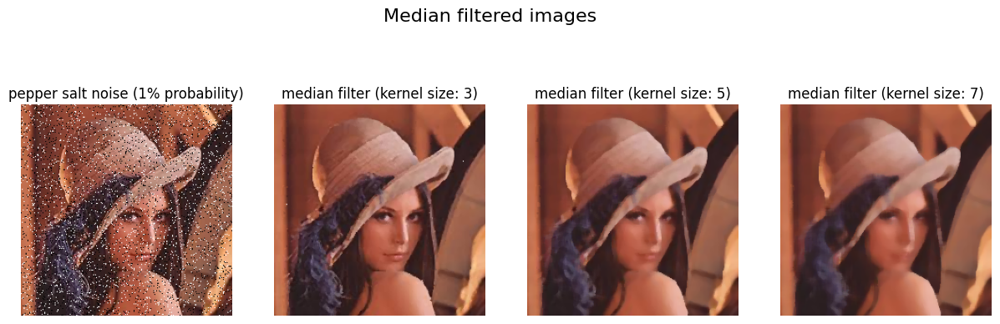

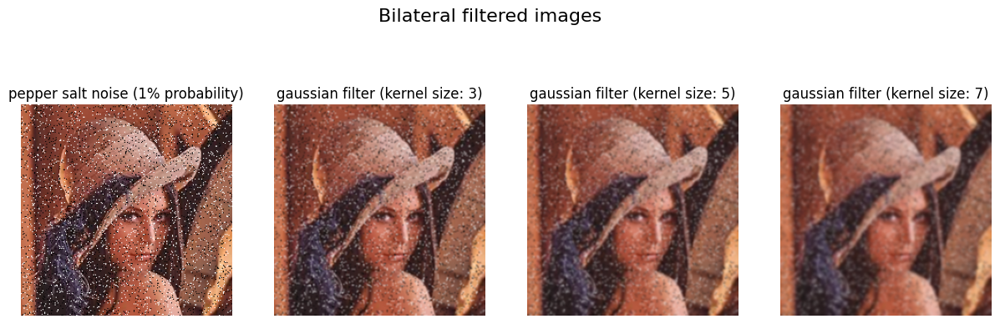

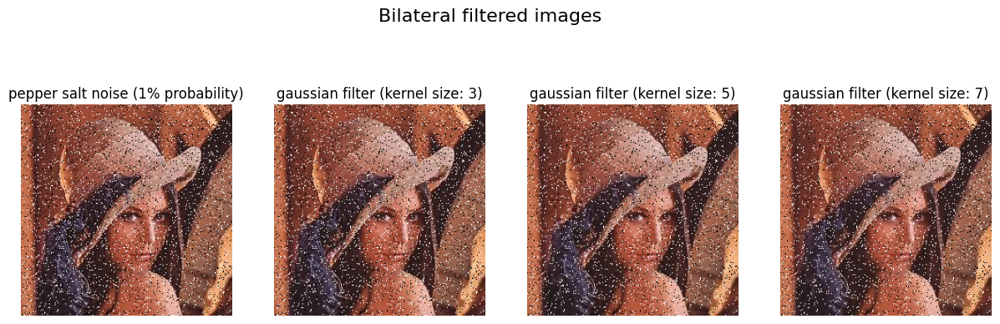

In [ ]:
filter_pepper_salt.show_median_filtered_image()
filter_pepper_salt.show_gaussian_filtered_image()
filter_pepper_salt.show_bilateral_filtered_image()

### Filtering gaussian noise with 1 std

In [ ]:
filter_gaussian= Filter(image_noise.select_image("gaussian_noise_1"), 'Gaussian noise (1 std)')

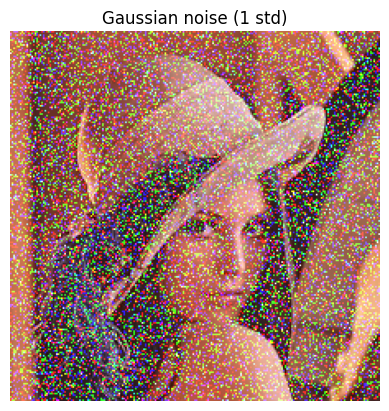

In [ ]:
filter_gaussian.show_filtering_image()

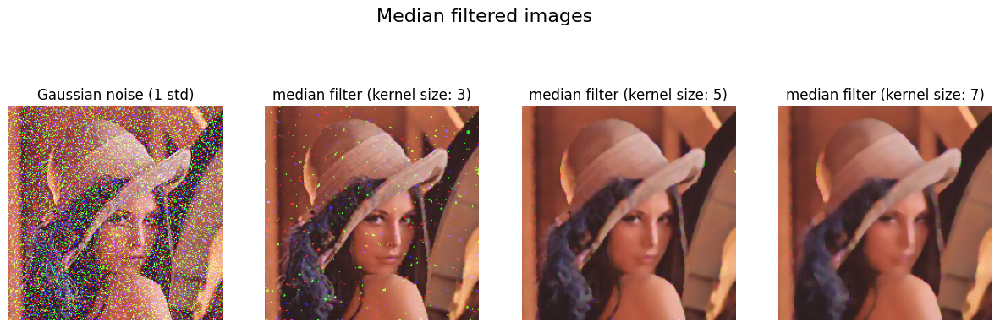

In [ ]:
for i in [3, 5, 7]:
  filter_gaussian.median_filter(i)
filter_gaussian.show_median_filtered_image()

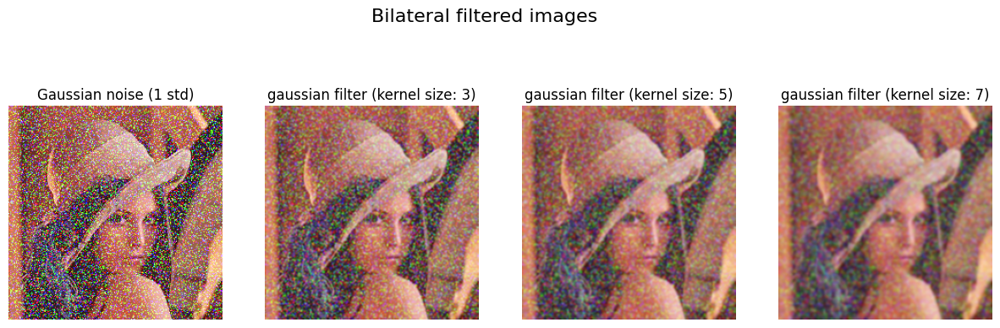

In [ ]:
for i in [3, 5, 7]:
  filter_gaussian.gaussian_filter(i)
filter_gaussian.show_gaussian_filtered_image()

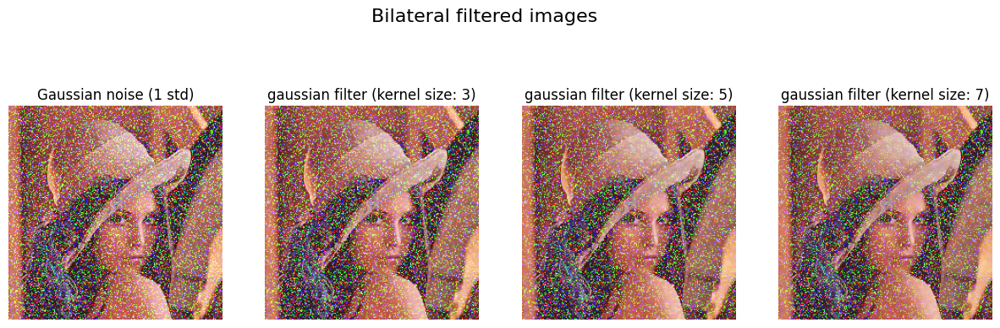

In [ ]:
for i in [3, 5, 7]:
  filter_gaussian.bilateral_filter(i)
filter_gaussian.show_bilateral_filtered_image()

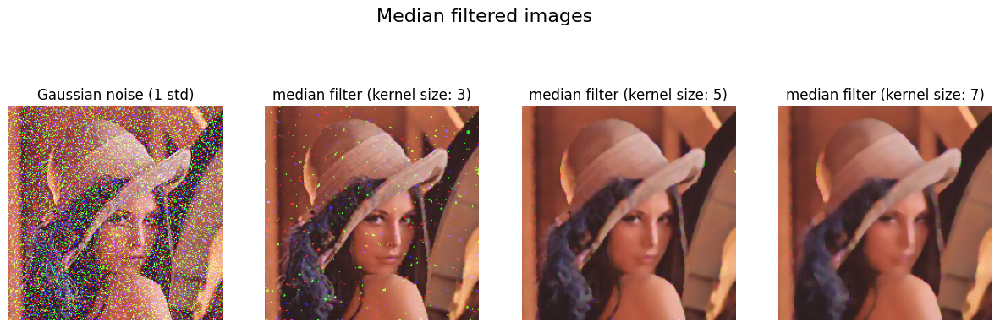

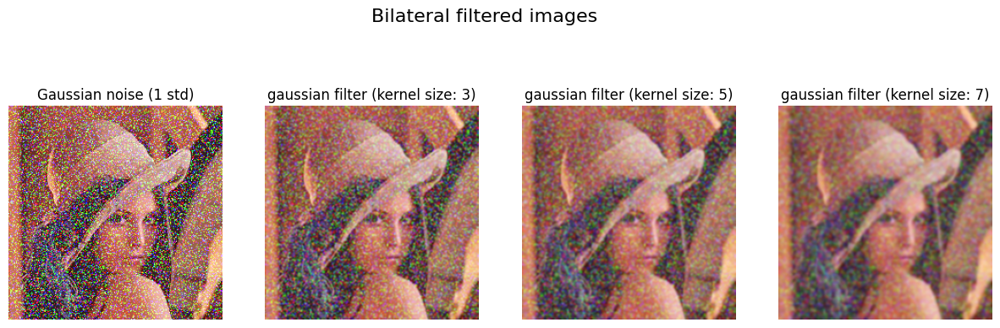

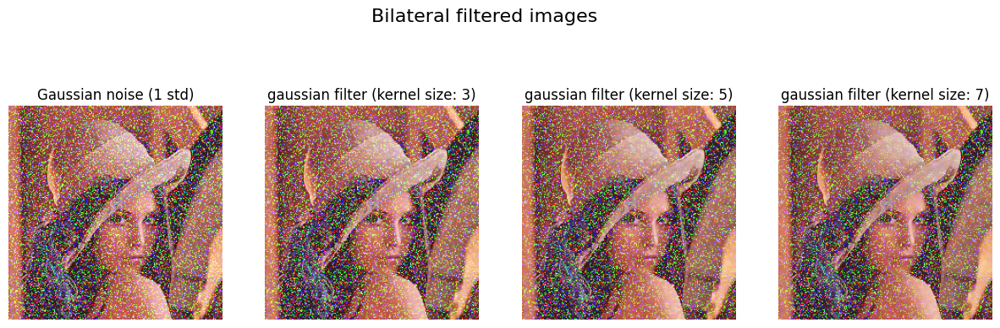

In [ ]:
filter_gaussian.show_median_filtered_image()
filter_gaussian.show_gaussian_filtered_image()
filter_gaussian.show_bilateral_filtered_image()

### Filtering gaussian noise with 0.5 std

In [ ]:
filter_gaussian_0_5= Filter(image_noise.select_image("gaussian_noise_0.5"), 'Gaussian noise (0.5 std)')

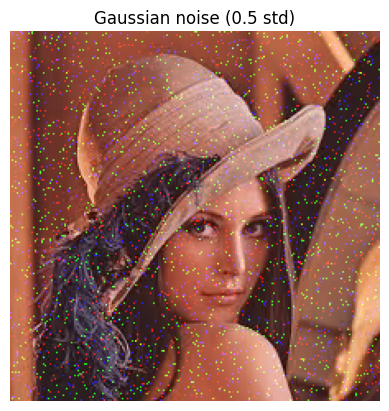

In [ ]:
filter_gaussian_0_5.show_filtering_image()

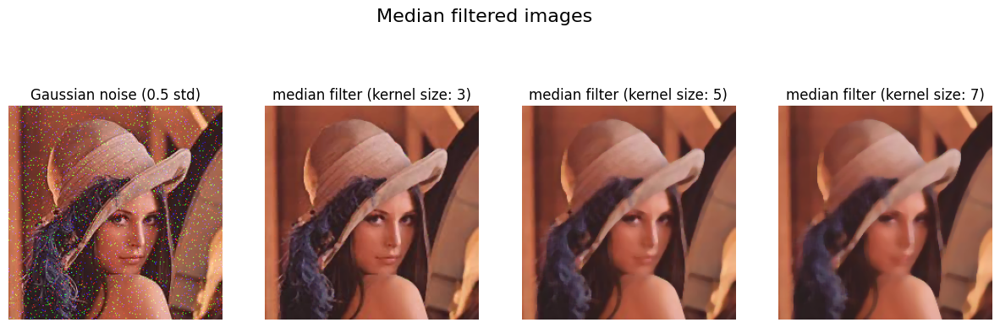

In [ ]:
for i in [3, 5, 7]:
  filter_gaussian_0_5.median_filter(i)
filter_gaussian_0_5.show_median_filtered_image()

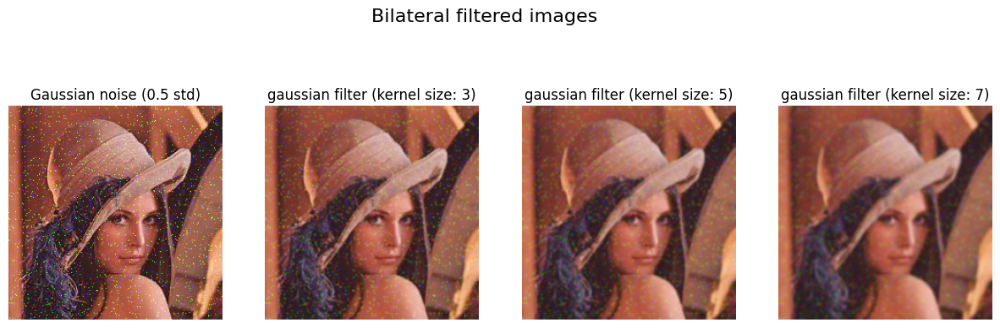

In [ ]:
for i in [3, 5, 7]:
  filter_gaussian_0_5.gaussian_filter(i)
filter_gaussian_0_5.show_gaussian_filtered_image()

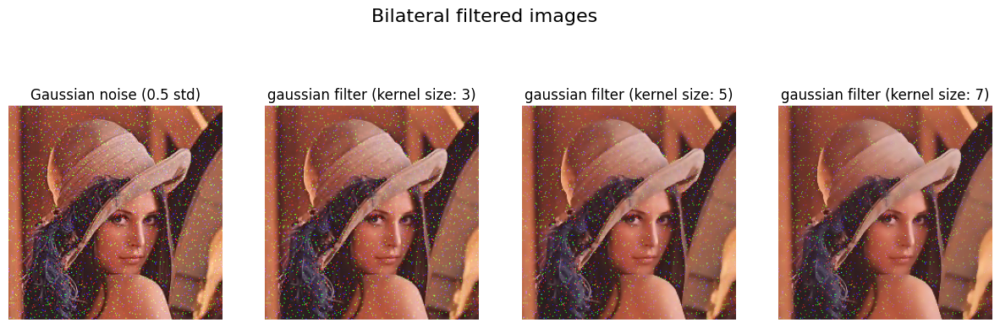

In [ ]:
for i in [3, 5, 7]:
  filter_gaussian_0_5.bilateral_filter(i)
filter_gaussian_0_5.show_bilateral_filtered_image()

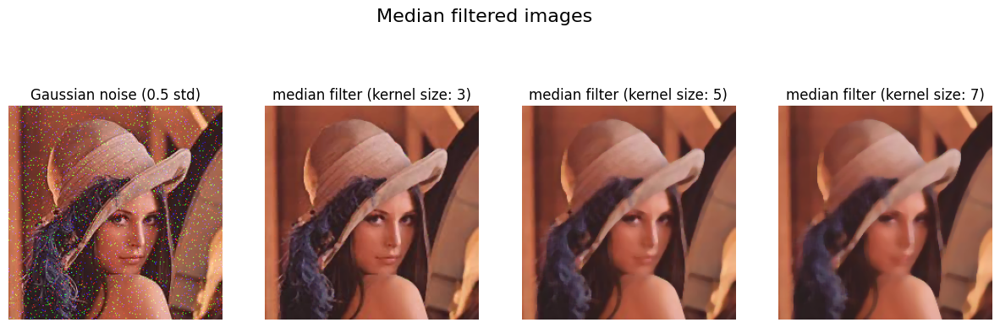

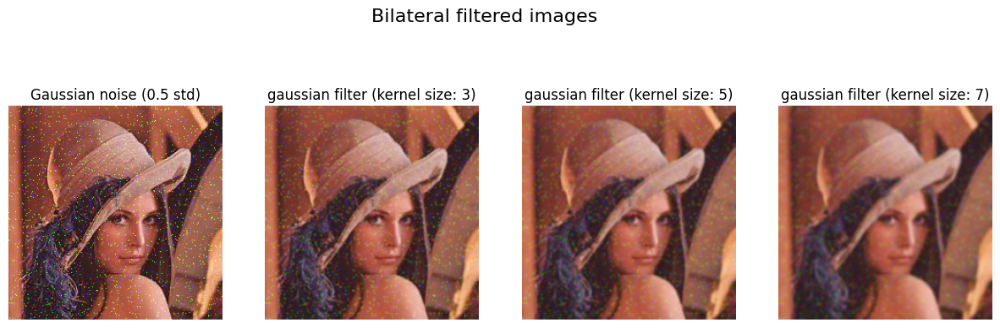

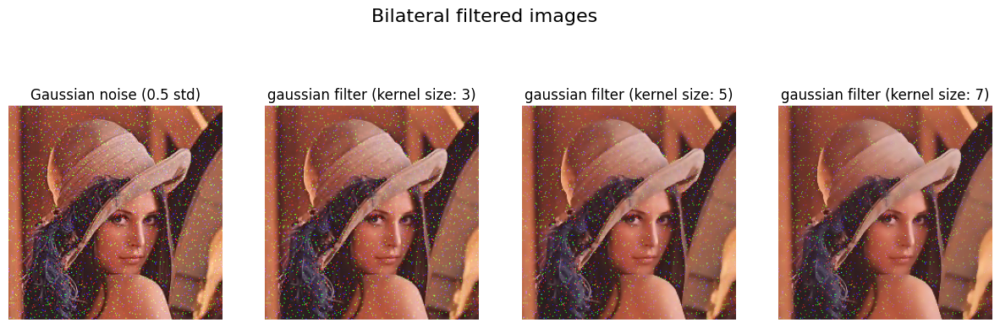

In [ ]:
filter_gaussian_0_5.show_median_filtered_image()
filter_gaussian_0_5.show_gaussian_filtered_image()
filter_gaussian_0_5.show_bilateral_filtered_image()

# Referências
https://www.askpython.com/python/examples/adding-noise-images-opencv

https://docs.opencv.org/3.4/d5/d69/tutorial_py_non_local_means.html

